In [2]:
import numpy as np 
import pandas as pd 
import requests 
import re 
import matplotlib.pyplot as plt 
from bs4 import BeautifulSoup
import seaborn as sns 

# gather data using worldweatheronline.com api 

In [113]:
import requests    
from calendar import monthrange

def data(year,month,tp,columns):
    num_day = monthrange(year, month)[1]

    api_key = '0ec08197e9a344dc83b71630211906'
    location = 'Tehran,Iran'
    date = '%s-%s-01'%(year,month)
    end_date = '%s-%s-%s'%(year,month,num_day)
    url = 'https://api.worldweatheronline.com/premium/v1/past-weather.ashx?key=%s&q=%s&date=%s&enddate=%s&format=json&tp=%s&includelocation=no'%(api_key,location,date,end_date,tp)
    res = requests.get(url)
    make_csv(year,res,tp,columns)

def make_csv(year,res,tp,columns):
    global counter
    global df

    json=res.json()['data']['weather']
    if tp==24:
        for i in range(len(json)):
    
            for index,item in enumerate(columns[:6]):
                df.loc[counter,item] = (json[i])[columns[index]]

            for index,item in enumerate(columns[6:],start=6):
                df.loc[counter,item] = (json[i])['hourly'][0][columns[index]] 
            counter+=1
    
    elif tp==1:

        for i in range(len(json)):
    
            #for index,item in enumerate(columns[:6]):
             #   df.loc[counter,item] = (res.json()['data']['weather'][i])[columns[index]]

            for j in range(24):
                df.loc[counter,'date'] = (json[i])['date']
                df.loc[counter,'hour'] = int((json[i])['hourly'][j]['time'])/100
                for index,item in enumerate(columns[2:],start=2):
                    df.loc[counter,item] = (json[i])['hourly'][j][columns[index]] 
                counter+=1





columns_24 = ['date' ,'maxtempC', 'mintempC', 'avgtempC','totalSnow_cm', 'sunHour', 'windspeedKmph','winddirDegree', 'WindChillC','weatherCode','humidity','pressure','cloudcover','precipMM']

columns_1 = ['date','hour' ,'tempC' , 'windspeedKmph','winddirDegree','humidity','pressure','cloudcover','precipMM','uvIndex','DewPointC']

col = {'daily':columns_24, 'hourly': columns_1}

year = 2021
mons = list(range(1,6))

tp = 1
if tp == 1:
    df = pd.DataFrame(columns = col['hourly'])
    counter = 0
    for m in mons:
        print('\r',m,end='')
        data(year,m,tp,col['hourly'])
    df.to_csv('hourly-tables/%s-h.csv'%year)
    print('\nfinished')

elif tp == 24:
    df = pd.DataFrame(columns = col['daily'])
    counter = 0
    for m in mons:
        data(year,m,tp,col['daily'])
    df.to_csv('daily-tables/%s-d.csv'%year)

 5
finished


In [114]:
dd=pd.read_csv('hourly-tables/%s-h.csv'%year,index_col=0)

In [124]:
dfs=[]
for year in range(2010,2022):
    dfs.append(pd.read_csv('hourly-tables/%s-h.csv'%year,index_col=0))
meta=pd.concat(dfs,ignore_index=True)
meta.shape

(100056, 11)

# explore data 

Text(0.5, 0, 'date')

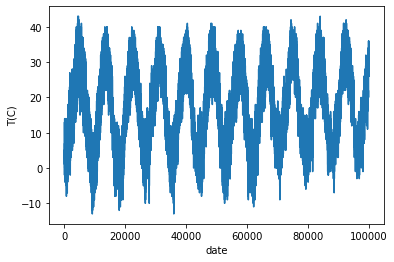

In [125]:
plt.plot(meta['tempC'])
plt.ylabel('T(C)')
plt.xlabel('date')

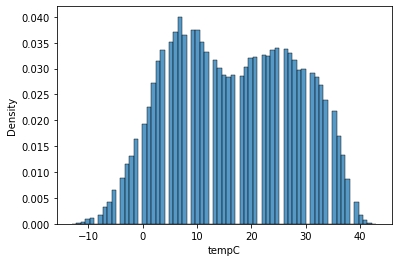

In [128]:
sns.histplot(data=meta,x='tempC',stat='density')
plt.show()

In [130]:
meta.columns

Index(['date', 'hour', 'tempC', 'windspeedKmph', 'winddirDegree', 'humidity',
       'pressure', 'cloudcover', 'precipMM', 'uvIndex', 'DewPointC'],
      dtype='object')

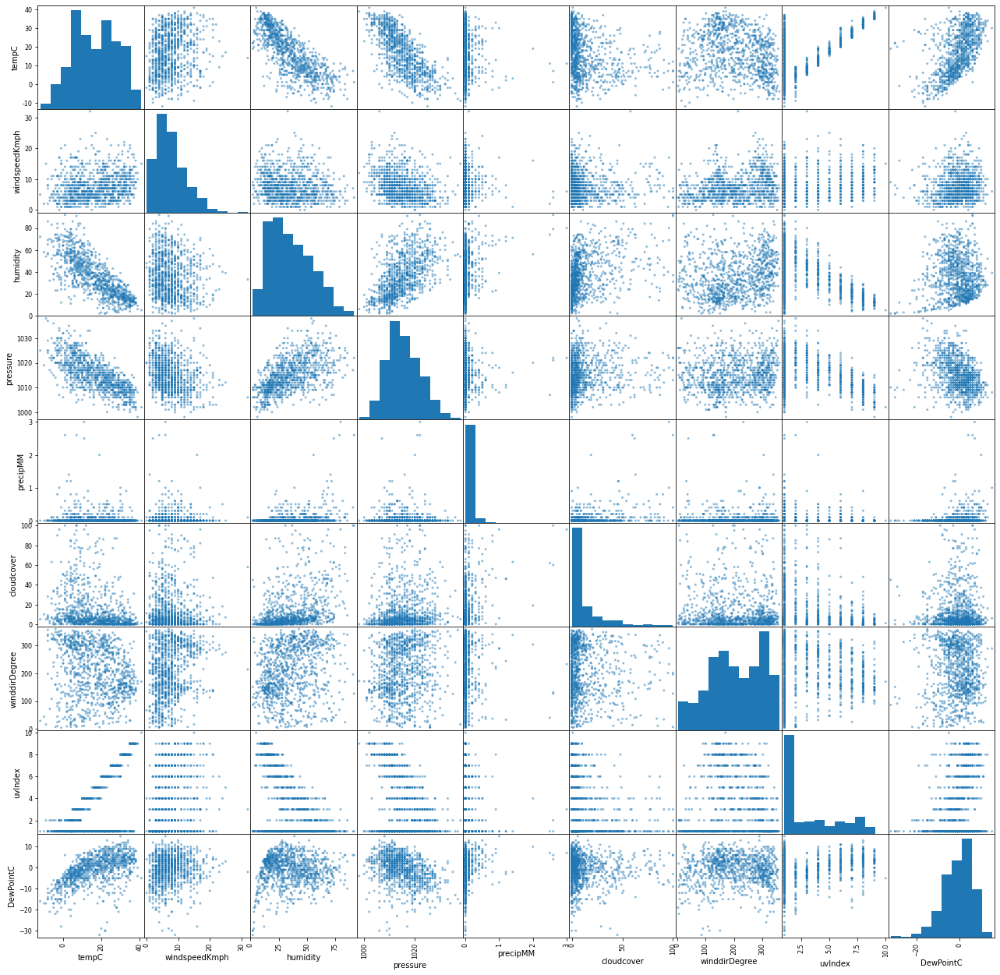

In [132]:
meta1 = meta.drop('date',axis=1)
features = ['tempC','windspeedKmph','humidity',  'pressure', 'precipMM','cloudcover','winddirDegree', 'uvIndex','DewPointC' ]
sample =  meta.sample(1000)[features]
pd.plotting.scatter_matrix(sample, figsize=(22,22))
plt.show()

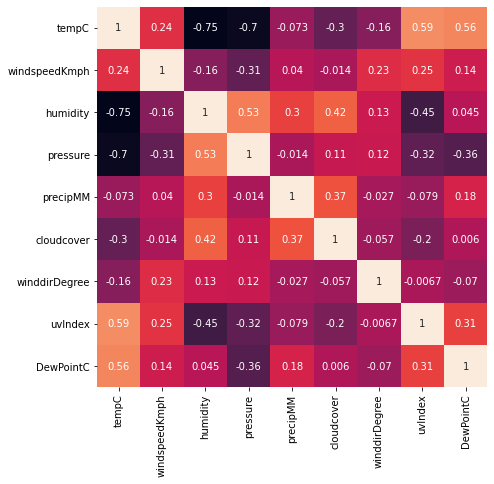

In [133]:
plt.figure(figsize=(7,7))
sns.heatmap(meta[features].corr(), annot=True,cbar=0)
plt.show()

In [137]:
meta

,date,hour,tempC,windspeedKmph,winddirDegree,humidity,pressure,cloudcover,precipMM,uvIndex,DewPointC
0,2010-01-01,0.0,5,4,330,64,1013,48,0.9,1,-1
1,2010-01-01,1.0,5,3,339,64,1013,43,0.5,1,-1
2,2010-01-01,2.0,5,3,348,64,1013,38,0.0,1,-1
3,2010-01-01,3.0,5,3,356,64,1012,33,0.0,1,-1
4,2010-01-01,4.0,5,4,339,65,1012,33,0.0,1,-1
...,...,...,...,...,...,...,...,...,...,...,...
100051,2021-05-31,19.0,29,11,301,7,1007,0,0.0,1,-7
100052,2021-05-31,20.0,28,9,318,7,1007,0,0.0,1,-7
100053,2021-05-31,21.0,26,8,334,8,1007,0,0.0,1,-6
100054,2021-05-31,22.0,27,8,335,9,1007,0,0.0,1,-5


In [135]:
df=pd.read_csv('fath-h.csv')

In [136]:
df

,date,hour,O3 ppb,CO ppm,NO ppb,NO2 ppb,NOx ppb,SO2 ppb,PM 10 ug/m3,PM 2.5 ug/m3
0,1389/04/13,0,2.0,19.0,351.0,119.0,470.0,19.0,224.0,NaN
1,1389/04/13,1,2.0,12.0,222.0,113.0,335.0,9.0,208.0,NaN
2,1389/04/13,2,2.0,9.0,204.0,101.0,305.0,15.0,208.0,NaN
3,1389/04/13,3,1.0,4.0,141.0,67.0,208.0,15.0,212.0,NaN
4,1389/04/13,4,2.0,2.0,72.0,55.0,128.0,10.0,165.0,NaN
...,...,...,...,...,...,...,...,...,...,...
83428,1400/03/29,19,50.0,1.0,7.0,24.0,31.0,3.0,67.0,NaN
83429,1400/03/29,20,40.0,1.0,13.0,34.0,48.0,3.0,63.0,NaN
83430,1400/03/29,21,27.0,1.0,19.0,44.0,62.0,3.0,69.0,NaN
83431,1400/03/29,22,15.0,1.0,23.0,55.0,78.0,3.0,68.0,NaN


In [138]:
import jdatetime
def index_corrector(df):
    ll=len(df.date)
    for index,item in enumerate(df['date']):
        print(f'\r {index} from {ll}',end='')
        l = item.split('/')
        gre = jdatetime.date(int(l[0]),int(l[1]),int(l[2])).togregorian()
        year = str(gre.year)
        mon = str(gre.month)
        if len(str(mon))==1:
            mon='0'+mon
        day = str(gre.day) 
        if len(str(day))==1:
            day='0'+day
    
        df.loc[index,'date'] = year+'-'+mon+'-'+day
    return df 

df=index_corrector(df)

In [139]:
df

,date,hour,O3 ppb,CO ppm,NO ppb,NO2 ppb,NOx ppb,SO2 ppb,PM 10 ug/m3,PM 2.5 ug/m3
0,2010-07-04,0,2.0,19.0,351.0,119.0,470.0,19.0,224.0,NaN
1,2010-07-04,1,2.0,12.0,222.0,113.0,335.0,9.0,208.0,NaN
2,2010-07-04,2,2.0,9.0,204.0,101.0,305.0,15.0,208.0,NaN
3,2010-07-04,3,1.0,4.0,141.0,67.0,208.0,15.0,212.0,NaN
4,2010-07-04,4,2.0,2.0,72.0,55.0,128.0,10.0,165.0,NaN
...,...,...,...,...,...,...,...,...,...,...
83428,2021-06-19,19,50.0,1.0,7.0,24.0,31.0,3.0,67.0,NaN
83429,2021-06-19,20,40.0,1.0,13.0,34.0,48.0,3.0,63.0,NaN
83430,2021-06-19,21,27.0,1.0,19.0,44.0,62.0,3.0,69.0,NaN
83431,2021-06-19,22,15.0,1.0,23.0,55.0,78.0,3.0,68.0,NaN


In [232]:
from datetime import date

d0 = date(2021, 1, 1)
d1 = date(2021, 6, 1)
delta = d1 - d0
print(delta.days)

151


In [216]:
4168*24

100032

In [140]:
df.date

0        2010-07-04
1        2010-07-04
2        2010-07-04
3        2010-07-04
4        2010-07-04
            ...    
83428    2021-06-19
83429    2021-06-19
83430    2021-06-19
83431    2021-06-19
83432    2021-06-19
Name: date, Length: 83433, dtype: object

In [141]:
meta.date

0         2010-01-01
1         2010-01-01
2         2010-01-01
3         2010-01-01
4         2010-01-01
             ...    
100051    2021-05-31
100052    2021-05-31
100053    2021-05-31
100054    2021-05-31
100055    2021-05-31
Name: date, Length: 100056, dtype: object

In [144]:
df.columns

Index(['date', 'hour', 'O3 ppb', 'CO ppm', 'NO ppb', 'NO2 ppb', 'NOx ppb',
       'SO2 ppb', 'PM 10 ug/m3', 'PM 2.5 ug/m3'],
      dtype='object')

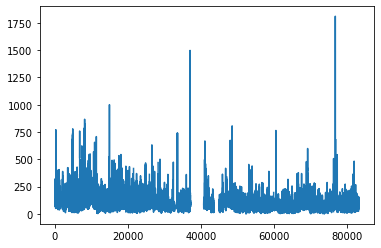

In [153]:
plt.plot(df['PM 10 ug/m3'])

In [199]:
df=df.set_index('date').drop(list(df.date)[-456:])

In [203]:
df=df.reset_index()

In [205]:
df

,date,hour,O3 ppb,CO ppm,NO ppb,NO2 ppb,NOx ppb,SO2 ppb,PM 10 ug/m3,PM 2.5 ug/m3
0,2010-07-04,0,2.0,19.0,351.0,119.0,470.0,19.0,224.0,NaN
1,2010-07-04,1,2.0,12.0,222.0,113.0,335.0,9.0,208.0,NaN
2,2010-07-04,2,2.0,9.0,204.0,101.0,305.0,15.0,208.0,NaN
3,2010-07-04,3,1.0,4.0,141.0,67.0,208.0,15.0,212.0,NaN
4,2010-07-04,4,2.0,2.0,72.0,55.0,128.0,10.0,165.0,NaN
...,...,...,...,...,...,...,...,...,...,...
82972,2021-05-31,19,44.0,1.0,8.0,25.0,33.0,2.0,43.0,NaN
82973,2021-05-31,20,32.0,1.0,11.0,31.0,42.0,2.0,38.0,NaN
82974,2021-05-31,21,21.0,1.0,15.0,42.0,57.0,2.0,31.0,NaN
82975,2021-05-31,22,6.0,3.0,66.0,66.0,132.0,3.0,28.0,NaN


In [208]:
meta.to_csv('hourly-tables/meta-d.csv')

In [211]:
df.drop('PM 2.5 ug/m3',axis=1).to_csv('hourly-tables/pollution-h.csv')

In [261]:
df = pd.read_csv('hourly-tables/pollution-h.csv',index_col=0)

In [262]:
df

,date,hour,O3 ppb,CO ppm,NO ppb,NO2 ppb,NOx ppb,SO2 ppb,PM 10 ug/m3
0,2010-07-04,0,2.0,19.0,351.0,119.0,470.0,19.0,224.0
1,2010-07-04,1,2.0,12.0,222.0,113.0,335.0,9.0,208.0
2,2010-07-04,2,2.0,9.0,204.0,101.0,305.0,15.0,208.0
3,2010-07-04,3,1.0,4.0,141.0,67.0,208.0,15.0,212.0
4,2010-07-04,4,2.0,2.0,72.0,55.0,128.0,10.0,165.0
...,...,...,...,...,...,...,...,...,...
82972,2021-05-31,19,44.0,1.0,8.0,25.0,33.0,2.0,43.0
82973,2021-05-31,20,32.0,1.0,11.0,31.0,42.0,2.0,38.0
82974,2021-05-31,21,21.0,1.0,15.0,42.0,57.0,2.0,31.0
82975,2021-05-31,22,6.0,3.0,66.0,66.0,132.0,3.0,28.0


In [263]:
meta

,date,hour,tempC,windspeedKmph,winddirDegree,humidity,pressure,cloudcover,precipMM,uvIndex,DewPointC
0,2010-01-01,0.0,5,4,330,64,1013,48,0.9,1,-1
1,2010-01-01,1.0,5,3,339,64,1013,43,0.5,1,-1
2,2010-01-01,2.0,5,3,348,64,1013,38,0.0,1,-1
3,2010-01-01,3.0,5,3,356,64,1012,33,0.0,1,-1
4,2010-01-01,4.0,5,4,339,65,1012,33,0.0,1,-1
...,...,...,...,...,...,...,...,...,...,...,...
100051,2021-05-31,19.0,29,11,301,7,1007,0,0.0,1,-7
100052,2021-05-31,20.0,28,9,318,7,1007,0,0.0,1,-7
100053,2021-05-31,21.0,26,8,334,8,1007,0,0.0,1,-6
100054,2021-05-31,22.0,27,8,335,9,1007,0,0.0,1,-5


In [264]:
df.date = pd.to_timedelta(df['hour'], unit='H') + pd.to_datetime(df['date'])

In [268]:
df = df.set_index('date')

In [272]:
idx = pd.date_range(df.index[0], '2021-06-1',freq='h')[:-1]
df = df.reindex(idx, fill_value=np.nan)

In [275]:
df.drop('hour',inplace=True,axis=1)

In [276]:
df

,O3 ppb,CO ppm,NO ppb,NO2 ppb,NOx ppb,SO2 ppb,PM 10 ug/m3
2010-07-04 00:00:00,2.0,19.0,351.0,119.0,470.0,19.0,224.0
2010-07-04 01:00:00,2.0,12.0,222.0,113.0,335.0,9.0,208.0
2010-07-04 02:00:00,2.0,9.0,204.0,101.0,305.0,15.0,208.0
2010-07-04 03:00:00,1.0,4.0,141.0,67.0,208.0,15.0,212.0
2010-07-04 04:00:00,2.0,2.0,72.0,55.0,128.0,10.0,165.0
...,...,...,...,...,...,...,...
2021-05-31 19:00:00,44.0,1.0,8.0,25.0,33.0,2.0,43.0
2021-05-31 20:00:00,32.0,1.0,11.0,31.0,42.0,2.0,38.0
2021-05-31 21:00:00,21.0,1.0,15.0,42.0,57.0,2.0,31.0
2021-05-31 22:00:00,6.0,3.0,66.0,66.0,132.0,3.0,28.0


In [278]:
meta.date = pd.to_timedelta(meta['hour'], unit='H') + pd.to_datetime(meta['date'])
meta = meta.set_index('date')
idx = pd.date_range(meta.index[0], '2021-06-1',freq='h')[:-1]
meta = meta.reindex(idx, fill_value=np.nan)
meta.drop('hour',inplace=True,axis=1)

In [279]:
meta

,tempC,windspeedKmph,winddirDegree,humidity,pressure,cloudcover,precipMM,uvIndex,DewPointC
2010-01-01 00:00:00,5,4,330,64,1013,48,0.9,1,-1
2010-01-01 01:00:00,5,3,339,64,1013,43,0.5,1,-1
2010-01-01 02:00:00,5,3,348,64,1013,38,0.0,1,-1
2010-01-01 03:00:00,5,3,356,64,1012,33,0.0,1,-1
2010-01-01 04:00:00,5,4,339,65,1012,33,0.0,1,-1
...,...,...,...,...,...,...,...,...,...
2021-05-31 19:00:00,29,11,301,7,1007,0,0.0,1,-7
2021-05-31 20:00:00,28,9,318,7,1007,0,0.0,1,-7
2021-05-31 21:00:00,26,8,334,8,1007,0,0.0,1,-6
2021-05-31 22:00:00,27,8,335,9,1007,0,0.0,1,-5


In [283]:
meta.loc[df.index]

,tempC,windspeedKmph,winddirDegree,humidity,pressure,cloudcover,precipMM,uvIndex,DewPointC
2010-07-04 00:00:00,22,13,25,34,1008,4,0.0,1,5
2010-07-04 01:00:00,21,14,134,35,1008,4,0.0,1,5
2010-07-04 02:00:00,21,16,242,37,1009,5,0.0,1,6
2010-07-04 03:00:00,20,17,350,39,1009,5,0.0,1,6
2010-07-04 04:00:00,22,14,248,37,1009,5,0.0,1,6
...,...,...,...,...,...,...,...,...,...
2021-05-31 19:00:00,29,11,301,7,1007,0,0.0,1,-7
2021-05-31 20:00:00,28,9,318,7,1007,0,0.0,1,-7
2021-05-31 21:00:00,26,8,334,8,1007,0,0.0,1,-6
2021-05-31 22:00:00,27,8,335,9,1007,0,0.0,1,-5


In [285]:
mega = pd.concat([meta.loc[df.index],df],axis=1)

In [286]:
mega.head()

,tempC,windspeedKmph,winddirDegree,humidity,pressure,cloudcover,precipMM,uvIndex,DewPointC,O3 ppb,CO ppm,NO ppb,NO2 ppb,NOx ppb,SO2 ppb,PM 10 ug/m3
2010-07-04 00:00:00,22,13,25,34,1008,4,0.0,1,5,2.0,19.0,351.0,119.0,470.0,19.0,224.0
2010-07-04 01:00:00,21,14,134,35,1008,4,0.0,1,5,2.0,12.0,222.0,113.0,335.0,9.0,208.0
2010-07-04 02:00:00,21,16,242,37,1009,5,0.0,1,6,2.0,9.0,204.0,101.0,305.0,15.0,208.0
2010-07-04 03:00:00,20,17,350,39,1009,5,0.0,1,6,1.0,4.0,141.0,67.0,208.0,15.0,212.0
2010-07-04 04:00:00,22,14,248,37,1009,5,0.0,1,6,2.0,2.0,72.0,55.0,128.0,10.0,165.0


In [315]:
mega.to_csv('hourly-tables/mega-h.csv',date_format='%Y-%m-%d %H:%M:%S')

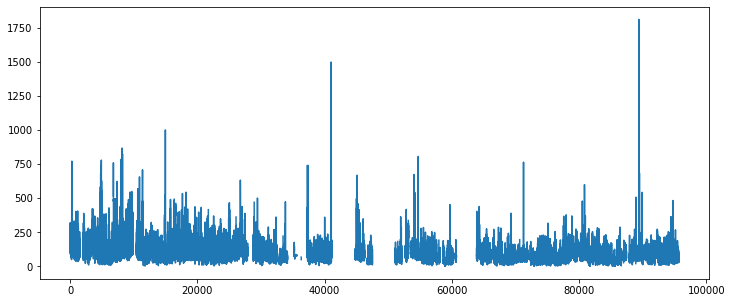

In [302]:
plt.figure(figsize=(12,5))
plt.plot(mega['PM 10 ug/m3'].values)

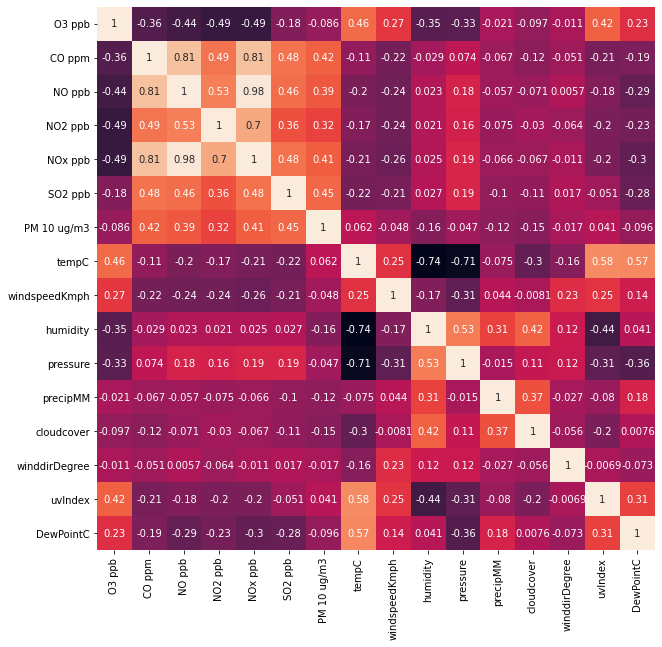

In [304]:
plt.figure(figsize=(10,10))
polutions = list(df.columns)
pol_cli = polutions+features
sns.heatmap(mega[pol_cli].corr(), annot=True,cbar=0)
plt.show()

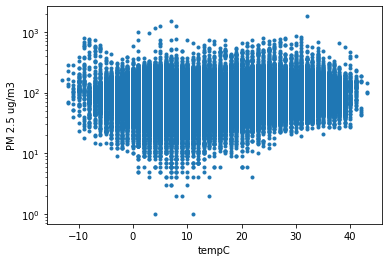

In [312]:
plt.plot(mega['tempC'],mega['PM 10 ug/m3'],'.')
plt.xlabel('tempC')
plt.ylabel('PM 2.5 ug/m3')
#plt.xscale('log')
plt.yscale('log')
plt.show()

In [314]:
mega.index

DatetimeIndex(['2010-07-04 00:00:00', '2010-07-04 01:00:00',
               '2010-07-04 02:00:00', '2010-07-04 03:00:00',
               '2010-07-04 04:00:00', '2010-07-04 05:00:00',
               '2010-07-04 06:00:00', '2010-07-04 07:00:00',
               '2010-07-04 08:00:00', '2010-07-04 09:00:00',
               ...
               '2021-05-31 14:00:00', '2021-05-31 15:00:00',
               '2021-05-31 16:00:00', '2021-05-31 17:00:00',
               '2021-05-31 18:00:00', '2021-05-31 19:00:00',
               '2021-05-31 20:00:00', '2021-05-31 21:00:00',
               '2021-05-31 22:00:00', '2021-05-31 23:00:00'],
              dtype='datetime64[ns]', length=95640, freq='H')